In [451]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import time
from tqdm import tqdm

In [432]:
W = np.ones((2,2))
b = np.ones(1)
grads = [np.zeros_like(W), np.zeros_like(b)]

dW = np.array(range(4)).reshape((2,2))
db = np.array(range(1)).reshape((1,1))
grads[0] = dW
grads[1][...] = db
print(grads[0].dtype,'\n', grads[1], '\n',grads)

int64 
 [0.] 
 [array([[0, 1],
       [2, 3]]), array([0.])]


In [433]:
class TimeMeanSquaredError: #batch 내의 1개 seq당 loss를 구해서 더하고 나중에 batch_size로 나눠줄거임 = 1 batch 1 loss
    #1개의 TimeRNN당 1개 loss
    def __init__(self):
        self.params, self.grads = [], []
        self.cache = None 

    def forward(self, hs, ts): #batch 1개에 들어있는 전체 seq
        #hs, ts.shape = (N,D)
        diff = hs - ts
        square = diff ** 2
        #print("square.shape:", square.shape) #(N,D)
        loss = np.mean(square)
        self.cache = (diff, square, hs.shape)
        return loss #1개의 값이 됨

    def backward(self, dout=1): 
        diff, square, shape = self.cache
        batch_size = shape[0]
        dx = (diff * 2) / batch_size * dout 
        print("TimeMSE.backward, dx.shape:", dx.shape) #(N,D)
        return dx 

In [434]:
#각 x에 대한 모든 y는 필요 없으므로 affine은 Time만 필요(y끼리는 연결성 없음)
class TimeAffine: #TimeRNN으로 출력값(은닉상태, hs)을 x(input)로 받아서 최종 출력값(y값)을 뱉어냄
    def __init__(self, W, b):
        self.params = [W, b]
        self.grads = [np.zeros_like(W), np.zeros_like(b)]
        self.x = None

    def forward(self, x):
        N, T, H = x.shape #(N,T,D) 였는데, TimeAffine에 들어오는 값은 은닉상태 hs이므로 전체 모델 X와 헷갈려서 D->H로 바꿈 : (2,5,1)
        print("TimeAffine.forward:, x.shape:", x.shape)
        W, b = self.params #(H,1), (1)
        rx = x.reshape(N*T, -1) #(N*T,H), input 차원을 없애서 (N,T,H)->(N*T,H)
        out = np.dot(rx, W) + b
        rout = out.reshape(N,T,-1)
        self.x = x
        print("TimeAffine.forward, rout.shape:", rout.shape) #(2,5,1)
        return rout

    def backward(self, dout): #(N,D)
        x = self.x[:,-1,:]
        #N, T, H = x.shape
        N, D = x.shape
        print("x.shape", x.shape)
        W, b = self.params

        #dout = dout.reshape(N*T, -1)
        #rx = x.reshape(N*T, -1)

        db = np.sum(dout, axis=0)
        #dW = np.dot(rx.T, dout)
        dW = np.dot(x.T, dout)
        dx = np.dot(dout, W.T)
        dx = dx.reshape(*x.shape) #??

        self.grads[0][...] = dW #[...] : int를 float로 바꿔줌
        self.grads[1][...] = db

        return dx

In [435]:
class RNN:
    def __init__(self, Wx, Wh, b):
        self.params = [Wx, Wh, b]
        #np.zeros_like(x) : x의 shape과 type에 맞춰 0-array
        self.grads = [np.zeros_like(Wx), np.zeros_like(Wh), np.zeros_like(b)] #grad 초깃값=0
        self.cache = None

    def forward(self, x, h_prev):
        Wx, Wh, b = self.params 
        t = np.dot(h_prev, Wh) + np.dot(x, Wx) + b #h_now
        h_next = np.tanh(t)

        #cache : return으로 내뱉지는 못하는데, 역전파 계산을 위해 저장은 해야해서
        self.cache = (x, h_prev, h_next)
        return h_next

    def backward(self, dh_next):
        Wx, Wh, b = self.params
        x, h_prev, h_next = self.cache #forward.cache에서 가져옴
        #후에 total_loss 미분 과정에서 각 시점마다 각 변수에 대한 미분이 필요함
        # 역으로 돌아오는 글로벌 그래디언트(loss에 대한 이전 편미분값) x 로컬 그래디언트(원하는 변수에 대한 편미분=미리 구할 수 있음)
        dt = dh_next * (1 - h_next ** 2) # dh_next x (tanh(t))'
        db = np.sum(dt, axis=0) #행방향 덧셈, 행 차원 없어짐
        dWh = np.dot(h_prev.T, dt) # dt x Wh에 곱해진 h_prev (multiply는 switch해서 곱해줌)
        dh_prev = np.dot(dt, Wh.T) 
        dWx = np.dot(x.T, dt)
        dx = np.dot(dt, Wx.T)

        #gradient update
        self.grads[0][...] = dWx #[...]은 왜하는거?
        self.grads[1][...] = dWh
        self.grads[2][...] = db

        return dx, dh_prev #forward의 input에 대한 그래디언트

In [436]:
class TimeRNN: #(RNN x seq_length) 1개를 한꺼번에 처리하는 계층
    def __init__(self, Wx, Wh, b, stateful=False):
        self.params = [Wx, Wh, b]
        self.grads = [np.zeros_like(Wx), np.zeros_like(Wh), np.zeros_like(b)]
        self.layers = None #RNN 계층 T개를 리스트로 저장
        
        self.h, self.dh = None, None #마지막 RNN의 h_next 저장 #이전 TimeRNN 계층으로 전달해줄 dh_prev
        #stateful=True : 해당 시간(RNN)의 은닉상태(h_next)를 메모리에서 기억하여 TimeRNN에서 forward를 이어가게 해줌
        self.stateful = stateful #boolean값, 은닉 상태를 인계받을지 조정

    def set_state(self, h): #hidden state 설정
        self.h = h

    def reset_state(self): #hidden state 초기화
        self.h = None
        
    def forward(self, xs): #x 모음->xs(T개의 시계열데이터)
        Wx, Wh, b = self.params
        #N : mini_batch_size, T : seq_length, D : input_size(입력데이터 종류)
        N, T, D = xs.shape
        D, H = Wx.shape 
         
        if not self.stateful or self.h is None: #저장된 h가 없을 때=처음 호출 시 0행렬
            self.h = np.zeros((N, H), dtype='float') #T번째의 h_next
        
        hs = np.empty((N, T, H), dtype='float') #dtype='float64'
        self.layers = []
        
        for t in range(T): 
            #같은 TimeRNN 내의 RNN[T]들은 합치면 하나의 계층
            layer = RNN(*self.params) #그래서 T가 변해도 같은 params 넣는다 
            self.h = layer.forward(xs[:, t, :], self.h) #T번째 RNN의 h_next
            hs[:, t, :] = self.h #hs에 T개의 h_next 순서대로 저장
            self.layers.append(layer) #RNN 모아서 TimeRNN이 됨
        print("TimeRNN, hs.shape:", hs.shape)
        return hs #h_next 모음->hs


    #모든 t번째 RNN계층에서 timeaffine을 계산하지 않으니, 그로부터 거꾸로 오는 dhs[:,t,:]가 필요없다. 따라서 처음에 layer.backward에 넣는 기울기는 합산된 기울기가 아닌, dh_next만 넣으면 된다.
    #T번째 RNN계층은 timeaffine에서 받아온 dx를 dh(dh_next임)로 사용하므로 'dh=0'이 아닌 'dh=dhs'를 바로 넣으면 된다.  
    def backward(self, dhs): #Truncated BPTT #dhs(in) : seq_length 내의 dh 모음
        Wx, Wh, b = self.params
        #N,T,H = dhs.shape #(N,H)가 T개 dx
        print("TimeRNN.backward, dhs.shape", dhs.shape)
        N, D = dhs.shape
        D, H = Wx.shape 
        T = seq_length
        dxs = np.empty((N, T, D), dtype='float') #out
        #dh = 0
        dh = dhs
        grads = [0, 0, 0]
        for t in reversed(range(T)): #T번째 RNN부터 거꾸로 받아오기 0~(T-1)
            layer = self.layers[t] 
            #dx, dh = layer.backward(dhs[:, t, :] + dh) #(dht+dhnext) : 합산된 기울기 
            dx, dh = layer.backward(dh)
            # t번째 : dh=dh_next를 backward에 넣어서 new dh=dh_prev를 얻어냄, #(t-1)번째 : 앞에서 얻은 new dh를 dh_next로 사용
            dxs[:, t, :] = dx

            for i, grad in enumerate(layer.grads):
                grads[i] += grad #각 t_RNN 계층의 grad를 누적 합산

        for i, grad in enumerate(grads): #최종 합산된 grads(가중치 기울기) class.grads에 저장
            self.grads[i][...] = grad
            
        self.dh = dh

        return dxs

In [437]:
class SimpleRnn: #전체 input 개수 넣어야함
    def __init__(self, seq_length, input_dim, hidden_size):
        #input_shape=(seq_length,input_dim)
        T, D, H = seq_length, input_dim, hidden_size
        rn = np.random.randn

        #초기 가중치 설정
        rnn_Wx = (rn(D,H) / np.sqrt(D)).astype('f') #np.sqrt로 초기화 설정
        rnn_Wh = (rn(H, H) / np.sqrt(H)).astype('f')
        rnn_b = np.zeros(H).astype('f')
        affine_W = (rn(H, 1)) / np.sqrt(H).astype('f')  # Output size is 1 (for predicting temperature)
        affine_b = np.zeros(1).astype('f')

        # Layers
        self.layers = [
            TimeRNN(rnn_Wx, rnn_Wh, rnn_b, stateful=True),
            TimeAffine(affine_W, affine_b)
        ]
        self.loss_layer = TimeMeanSquaredError() # Use Mean Squared Error for regression problems
        self.rnn_layer = self.layers[0]

        # Parameters and gradients
        self.params, self.grads = [], []
        
        for layer in self.layers: # TimeRNN을 모든 seq_length에 대해 돌림
            self.params += layer.params
            self.grads += layer.grads

    def forward(self, xs, ts): #xs.shape=(N,T,D)
        for layer in self.layers:
            hs = layer.forward(xs) 
        print("SimpleRNN.forward, hs.shape:", hs.shape) #(N,T,D)
        loss = self.loss_layer.forward(hs[:,-1,:], ts) #(1)
        return loss 

    def backward(self, dout=1):
        dout = self.loss_layer.backward(dout) #(N,D)
        for layer in reversed(self.layers):
            dout = layer.backward(dout)
        print("SimpleRnn.backward, dout.shape:", dout.shape) #(2,5,1)
        return dout 

    def reset_state(self):
        self.rnn_layer.reset_state()

    def predict(self, xs): #timeaffine을 거쳐 나온 y값
        for layer in self.layers:
            out = layer.forward(xs)
        ys = out[:,-1,:]
        return ys

In [444]:
model = SimpleRnn(seq_length, input_dim, hidden_size)
optimizer = SGD(lr)
xss_train, tss_train = x_train_seq, y_train_seq

In [452]:
    #batch_size=N=1
    data_size = len(xss_train)
    max_iters = data_size // batch_size 
    time_list = []
    loss_list = []
    train_pred_list = []
    test_pred_list = []
   
    for epoch in (range(max_epoch)): 
        total_loss = 0
        loss_count = 0
        start_time = time.time()
        for iters in range(max_iters): #1번에 1개 batch(seq는 batch_size개)돌림
            batch_x = xss_train[iters*batch_size:(iters+1)*batch_size]
            batch_x = batch_x.reshape(batch_size,seq_length,-1)
            print("Train, batch_x.shape:", batch_x.shape) #(batch_size, seq_length, input_dim) 
            batch_t = tss_train[iters*batch_size:(iters+1)*batch_size]
            #print(batch_t.shape) #(batch_size, input_dim)
            
            # 기울기 구해 매개변수 갱신 
            loss = model.forward(batch_x, batch_t)
            model.backward()
            optimizer.update(model.params, model.grads)
            total_loss += loss #N개의 배치에 대한 손실을 모두 더함
            loss_count += 1 #max_iters

        avg_loss = total_loss / loss_count #배치 개수만큼(max_iters) 나누어 1개당 평균 손실을 최종 손실로 간주
        end_time = time.time()
        during_time= end_time - start_time
        time_list.append(during_time)
        loss_list.append(avg_loss)
        
        if epoch % 10 == 0:
            print(f"epoch: {epoch} | time: {during_time} | loss: {avg_loss}")

Train, batch_x.shape: (5, 5, 1)
TimeRNN, hs.shape: (5, 5, 1)
TimeAffine.forward:, x.shape: (5, 5, 1)
TimeAffine.forward, rout.shape: (5, 5, 1)
SimpleRNN.forward, hs.shape: (5, 5, 1)
TimeMSE.backward, dx.shape: (5, 1)
x.shape (5, 1)
TimeRNN.backward, dhs.shape (5, 1)
SimpleRnn.backward, dout.shape: (5, 5, 1)
Train, batch_x.shape: (5, 5, 1)
TimeRNN, hs.shape: (5, 5, 1)
TimeAffine.forward:, x.shape: (5, 5, 1)
TimeAffine.forward, rout.shape: (5, 5, 1)
SimpleRNN.forward, hs.shape: (5, 5, 1)
TimeMSE.backward, dx.shape: (5, 1)
x.shape (5, 1)
TimeRNN.backward, dhs.shape (5, 1)
SimpleRnn.backward, dout.shape: (5, 5, 1)
Train, batch_x.shape: (5, 5, 1)
TimeRNN, hs.shape: (5, 5, 1)
TimeAffine.forward:, x.shape: (5, 5, 1)
TimeAffine.forward, rout.shape: (5, 5, 1)
SimpleRNN.forward, hs.shape: (5, 5, 1)
TimeMSE.backward, dx.shape: (5, 1)
x.shape (5, 1)
TimeRNN.backward, dhs.shape (5, 1)
SimpleRnn.backward, dout.shape: (5, 5, 1)
Train, batch_x.shape: (5, 5, 1)
TimeRNN, hs.shape: (5, 5, 1)
TimeAffine.f

0.21281200833822725 0.05758114484229184


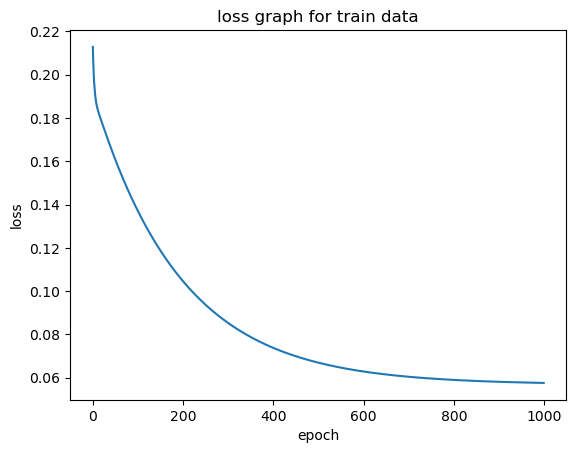

In [467]:
print(loss_list[0], loss_list[-1])
plt.plot(loss_list)
plt.xlabel('epoch')
plt.ylabel('loss')
plt.title('loss graph for train data')
plt.show()

In [468]:
xss_test, tss_test = x_test_seq, y_test_seq
data_size = len(xss_test)
max_iters = data_size // batch_size 
test_pred_list = []

for iters in range(max_iters):
    batch_x = xss_test[iters*batch_size:(iters+1)*batch_size]
    batch_x = batch_x.reshape(batch_size,seq_length,-1)
    test_pred = model.predict(batch_x).tolist()
    test_pred_list.append(test_pred)
test_pred_list = np.array(test_pred_list).flatten().tolist()

print(len(test_pred_list)) #60

train_pred_list=[]
for y in y_train_seq:
    train_pred_list.append(y.tolist())
train_pred_list = np.array(train_pred_list).flatten().tolist()

print(len(train_pred_list)) #300
print(type(x_train_seq[0].tolist()))
pred_list = x_train_seq[0].tolist() +train_pred_list + test_pred_list
print(len(pred_list)) #360

TimeRNN, hs.shape: (5, 5, 1)
TimeAffine.forward:, x.shape: (5, 5, 1)
TimeAffine.forward, rout.shape: (5, 5, 1)
TimeRNN, hs.shape: (5, 5, 1)
TimeAffine.forward:, x.shape: (5, 5, 1)
TimeAffine.forward, rout.shape: (5, 5, 1)
TimeRNN, hs.shape: (5, 5, 1)
TimeAffine.forward:, x.shape: (5, 5, 1)
TimeAffine.forward, rout.shape: (5, 5, 1)
TimeRNN, hs.shape: (5, 5, 1)
TimeAffine.forward:, x.shape: (5, 5, 1)
TimeAffine.forward, rout.shape: (5, 5, 1)
TimeRNN, hs.shape: (5, 5, 1)
TimeAffine.forward:, x.shape: (5, 5, 1)
TimeAffine.forward, rout.shape: (5, 5, 1)
TimeRNN, hs.shape: (5, 5, 1)
TimeAffine.forward:, x.shape: (5, 5, 1)
TimeAffine.forward, rout.shape: (5, 5, 1)
TimeRNN, hs.shape: (5, 5, 1)
TimeAffine.forward:, x.shape: (5, 5, 1)
TimeAffine.forward, rout.shape: (5, 5, 1)
TimeRNN, hs.shape: (5, 5, 1)
TimeAffine.forward:, x.shape: (5, 5, 1)
TimeAffine.forward, rout.shape: (5, 5, 1)
TimeRNN, hs.shape: (5, 5, 1)
TimeAffine.forward:, x.shape: (5, 5, 1)
TimeAffine.forward, rout.shape: (5, 5, 1)
T

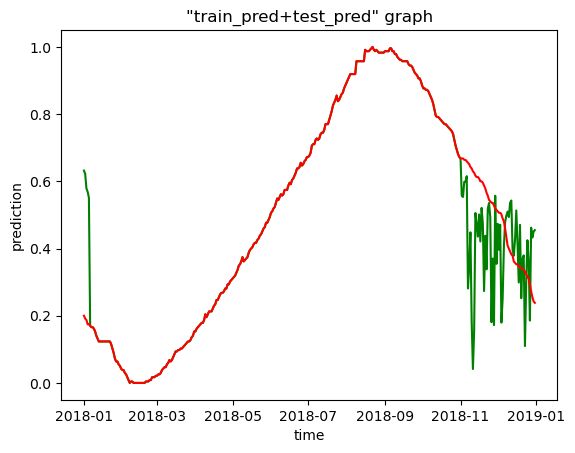

In [471]:
plt.plot(time, pred_list, '-g')
plt.plot(time, label_, '-r')
plt.xlabel('time')
plt.ylabel('prediction')
plt.title('"train_pred+test_pred" graph')
plt.show()

In [443]:
#미니 배치 확률적 경사 하강법
class SGD:
    def __init__(self, lr=0.01):
        self.lr = lr
        
    def update(self, params, grads):
        for i in range(len(params)):
            params[i] -= self.lr * grads[i]

### 데이터 전처리 - minmaxscaler / list 형태로 정리

In [460]:
#데이터의 값이 너무 크면 계산에 소요되는 시간이 늘어남 -> 값의 범위를 0~1로 변환
def MinMaxScale(data):
    numerator = data - min(data)
    denominator = max(data) - min(data)
    normalization = numerator / (denominator + 1e-7)
    return normalization

def inverse_MMS(scale_data,orig_data):
    print(type(scale_data[0]))
    print(type(orig_data[0]))
    denominator = max(orig_data)-min(orig_data)
    inverse_norm = scale_data*denominator + min(orig_data)
    return inverse_norm

len(dataset_) / len(label_) :  365 / 365


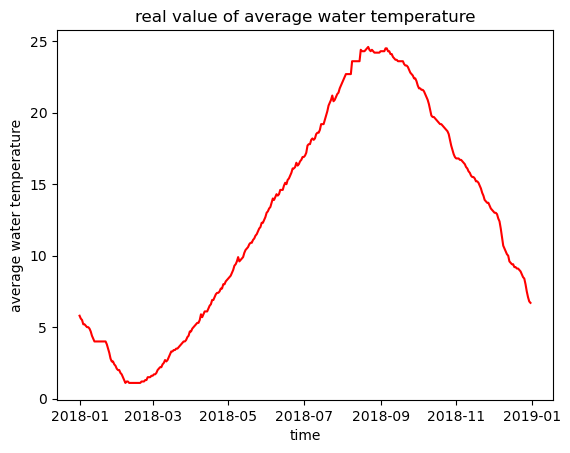

In [463]:
#pandas로 엑셀 파일 불러오기, ('')에 파일 경로를 불러오면 됨
time = pd.read_excel('/Users/gyuhuikwon/Desktop/data/edition/평균수온2018.xlsx')
time = time['시간'].values
raw_df = pd.read_excel('/Users/gyuhuikwon/Desktop/data/edition/CLM_이산화탄소2018.xlsx')
dataset = raw_df['평균이산화탄소배경대기농도(ppm)'].values
dataset_ = MinMaxScale(dataset)

label = pd.read_excel('/Users/gyuhuikwon/Desktop/data/edition/평균수온2018.xlsx')
label = label['평균수온(°∆C)'].values
label_ = MinMaxScale(label)

#print(type(label)) #numpy.ndarray
print("len(dataset_) / len(label_) : ", len(dataset), '/', len(label))
plt.plot(time, label, 'r')
#plt.plot(time, dataset, 'g')
plt.xlabel('time')
plt.ylabel('average water temperature')
plt.title('real value of average water temperature')
plt.show()

### 데이터 전처리2 - seq_length에 따른 입출력 데이터 정의

In [447]:
sequence_length = 5

def seq_data(x, y, sequence_length):
    x_seq, y_seq = [], []
    
    for i in range(len(x) - sequence_length):
        x_seq.append(x[i : i+sequence_length])
        y_seq.append(y[i+sequence_length])
    x_seq, y_seq = np.array(x_seq), np.array(y_seq).reshape([-1,1])
    return x_seq, y_seq
x_seq, y_seq = seq_data(dataset_, label_, sequence_length)

In [448]:
#아직 batch 나누지 않음 / seq_length로 나눔
split = 300
x_seq, y_seq = seq_data(dataset_, label_, sequence_length)
print(len(x_seq))
print(x_seq.shape) #(360,5) 
x_train_seq = x_seq[:split]
y_train_seq = y_seq[:split]
x_test_seq = x_seq[split:]
y_test_seq = y_seq[split:]

#print(type(x_seq)) #numpy.ndarray
#print(type(x_train_seq)) #numpy.ndarray

print("train data shape:", x_train_seq.shape, y_train_seq.shape)
print("target data shape:", x_test_seq.shape, y_test_seq.shape)

360
(360, 5)
train data shape: (300, 5) (300, 1)
target data shape: (60, 5) (60, 1)


### 하이퍼파라미터 설정

In [449]:
# 하이퍼파라미터 설정
batch_size = 5 #number of data in 1 batch
input_dim = 1 #number of node in input layer(for 1 time-step) : co2
hidden_size = 1  #number of node in hidden layer(for 1 time-step)
seq_length = 5
lr = 1e-3 #learning rate
max_epoch = 1000 #epoch